# Összefoglaló

## 2D Ising-modell
Ez a projekt a kétdimenziós Ising-modell Monte Carlo-szimulációját valósítja meg a Metropolis-algoritmus segítségével. Az Ising-modell egy matematikai modell, amelyet ferromágneses anyagok viselkedésének és fázisátalakulásainak vizsgálatára használnak.

A kétdimenziós Ising-modell egy olyan $L \times L$ rácsból áll, amelynek minden pontjában egy-egy spin található, ami +1 vagy -1 értéket vehet fel. Minden spin kölcsönhatásban van a közvetlen szomszédaival, és a rendszer a Metropolis-algoritmus alapján fejlődik. A szimuláció során a rendszer különböző fizikai jellemzőit (elrendezés energiája és mágnesezettsége) számítjuk ki.

A Metropolis-algoritmus fő lépései a következők:

1. Elkészítjük a kezdeti konfigurációt N db spinnel (a rendszernek $2^L$ lehetőség van).

2. Véletlenszerűen válasszunk ki egy rácspontot, és fordítsuk meg annak a spinjét.

3. Számítsuk ki az energiaváltozást,  $\Delta E$-t. Ha  $\Delta E$ < 0, fogadjuk el a lépést. Ellenkező esetben a lépést valószínűséggel $e^{-ΔE/T}$ fogadjuk el. Ez kielégíti a részletes egyensúly feltételét, és biztosítja, hogy a rendszer egyensúlyi állapotba jusson.

$$
   P_{\text{accept}} =
   \begin{cases}
   1 & \text{if } \Delta E \leq 0 \\
   e^{-\beta \Delta E} & \text{if } \Delta E > 0
   \end{cases}
   $$

4. Ismételjük meg a 2–4. lépéseket.

A kétdimenziós Ising-modell Hamilton-operátora külső mágneses tér (B) jelenlétében a következő alakot ölti:

$$
H(\boldsymbol{\sigma}) = -J \sum_{\langle i, j \rangle} \sigma_i \sigma_j - \mu B \sum_j \sigma_j
$$

Itt $𝑠_i$ jelöli az i-edik rácsponton lévő spint, amely +1 vagy -1 lehet. A $J$ a szomszédos spinek közötti kölcsönhatás erőssége, $μ$ az egyes spinek mágneses momentuma, $B$ pedig a külső mágneses tér erőssége. Az első összeg az összes szomszédos spinpárra vonatkozik, míg a második összeg a rács összes spinjére.

A rendszer másodrendű fázisátalakuláson megy keresztül a kritikus hőmérsékleten, $T_c$-nél. Ha a hőmérséklet kisebb, mint $T_c$ a rendszer mágnesezett állapotba kerül, amelyet ferromágnesesnek vagy rendezett állapotnak nevezünk. Ez a lokális kölcsönhatások miatt globálisan rendezett konfigurációt jelent. Ha a hőmérséklet nagyobb, mint $T_c$ a rendszer rendezetlen, ún. paramágneses állapotba kerül, ahol a spinek között nem alakulnak ki hosszú távú korrelációk.

A kód alapvetően két részből áll: 
1. egy adott hőmérsékleten a kezdeti konfigurációból eljuttatja az elrendezést az egyensúlyi állapotba, majd készít egy animációt a folyamatról
2. egy adott hőmérséklet intervallumról megadott számú hőmérséklet esetén elvégzi az előző rész első felét (eljuttatja egyensúlyba), majd ott további lépések során az adott konfiguráció egyensúlyhoz tartozó energiáját és mágnesezettségét átlagolással meghatározza. Ezt a folyamatot minden hőmérséklet esetén többször elvégzi a kód, majd a kapott egyensúlyi energiákat és mágnesezettségeket a hőmérséklet függvényében ábrázolja két grafikonon. 

# Kód

In [11]:
import numpy as np 
import matplotlib.pyplot as pl
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import numpy as np 
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from multiprocessing import Pool, cpu_count
import time

In [13]:
class IsingModel:
    def __init__(self, grid_size, temperature, J, h, mu):
        self.grid_size = grid_size
        self.temperature = temperature
        self.spins = np.random.choice([-1, 1], size=(grid_size, grid_size))
        self.J = J  
        self.h = h
        self.mu = mu

    def energy(self):
        energy = 0
        for i in range(self.grid_size):
            for j in range(self.grid_size):
                s = self.spins[i, j]
                s_neighbors = (
                    self.spins[(i + 1) % self.grid_size, j] +
                    self.spins[i, (j + 1) % self.grid_size] +
                    self.spins[(i - 1) % self.grid_size, j] +
                    self.spins[i, (j - 1) % self.grid_size]
                )
                energy += -(1/2) * self.J * s * s_neighbors - self.h * self.mu * s

        return energy    
    
    def delta_energy(self, i, j):
        s = self.spins[i, j]
        s_neighbors = (
            self.spins[(i + 1) % self.grid_size, j] +
            self.spins[i, (j + 1) % self.grid_size] +
            self.spins[(i - 1) % self.grid_size, j] +
            self.spins[i, (j - 1) % self.grid_size]
        )
        return 2 * s * (self.J * s_neighbors + self.h * self.mu)

    def magnetization(self):
        return np.mean(self.spins)    

### 1. rész - Animáció egy adott hőmérsékleten történő egyensúlyba jutásról

#### Függvények

In [15]:
def equilibrium(energies, eps, window):
    
    if len(energies) < window:
        return False
        
    recent = energies[-window:]
    diffs = np.abs(np.diff(recent))
    
    return np.all(diffs < eps )

In [17]:
def Metropolis_hastings(ising_model, steps, scalings, eps=1e-3, window=8000):

    (J_phys,  mu_phys) = scalings
    energies = []
    magnetizations = []    
    spin_grids = []
    step = 0
    
    while not equilibrium(energies, eps, window) and step < steps:
            
        i, j = np.random.randint(0, ising_model.grid_size, size=2)
        delta_E = ising_model.delta_energy(i, j)

        if delta_E < 0 or np.random.rand() < np.exp(-delta_E / (ising_model.temperature)):
            ising_model.spins[i, j] *= -1

        energies.append(ising_model.energy())
        magnetizations.append(ising_model.magnetization())        

        if step % 20 == 0:
            spin_grids.append(ising_model.spins.copy())

        step += 1
    
    E = np.mean(energies[-10:]) 
    M = np.mean(magnetizations[-10:]) 

    return E * J_phys, M * mu_phys, np.array(spin_grids) 

In [19]:
def spin_grid_animation(spin_grids, T, J, h, mu, save_path=None):

    fig, ax = plt.subplots()
    
    def update(frame):
        ax.clear()
        ax.imshow(spin_grids[frame], cmap='plasma', vmin=-1, vmax=1)
        ax.set_title(f'Spin Grid Evolution at T={T:.2f}K with h={h:.2}T outside field')
        ax.axis('off')

    ani = FuncAnimation(fig, update, frames=len(spin_grids), interval = 1)
    
    if save_path:
        ani.save(save_path, writer='imagemagick')
    
    return HTML(ani.to_jshtml())

#### Szimulációk

MovieWriter imagemagick unavailable; using Pillow instead.


Final energy: -3.2008e-18 J, Magnetization: 2.1042e-24 J/T


Animation size has reached 20977175 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


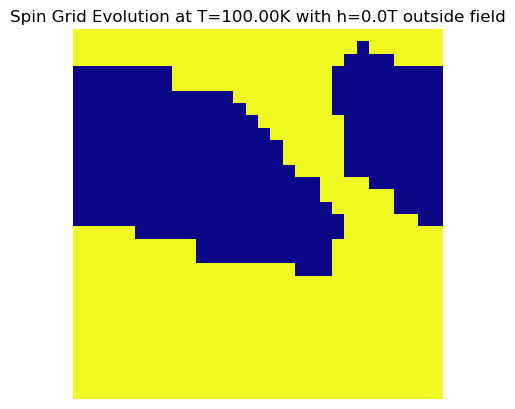

In [21]:
k_B = 1.380649e-23       # J/K
J_phys = 2.0e-21         # J
mu_phys = 9.2740100783e-24      # J/T

T_phys = 100  # K
h_phys = 0.  # T

T = T_phys * (k_B / J_phys)  # Dimensionless temperature
h = h_phys * (mu_phys / J_phys)  # Dimensionless field
J = 1.0
mu = mu_phys / J_phys  # Dimensionless magnetic moment 

grid_size = 30

ising_model = IsingModel(grid_size=grid_size, temperature=T, J=J, h=h, mu=mu)

steps = 40000
scalings = (J_phys, mu_phys)
energy, magnetization, spin_grids = Metropolis_hastings(ising_model, steps, scalings)

print(f"Final energy: {energy:.4e} J, Magnetization: {magnetization:.4e} J/T")

path = r'C:\Users\akosc\tudprog\ising_model_nhf\Ising_model_simulation\ising_model_animation_100K.gif'
spin_grid_animation(spin_grids, T_phys, J_phys, h_phys, mu_phys, save_path=path)

In [ ]:
k_B = 1.380649e-23       # J/K
J_phys = 2.0e-21         # J
mu_phys = 9.2740100783e-24      # J/T

T_phys = 50  # K
h_phys = 0.  # T

T = T_phys * (k_B / J_phys)  # Dimensionless temperature
h = h_phys * (mu_phys / J_phys)  # Dimensionless field
J = 1.0
mu = mu_phys / J_phys  # Dimensionless magnetic moment


grid_size = 60


ising_model = IsingModel(grid_size=grid_size, temperature=T, J=J, h=h, mu=mu)

steps = 50000
scalings = (J_phys, mu_phys)
energy, magnetization, spin_grids = Metropolis_hastings(ising_model, steps, scalings)

print(f"Final energy: {energy:.4e} J, Magnetization: {magnetization:.4e} J/T")

path = r'D:\Egyetem\Tudományos Programozás\Ising_model_simulation\plots_and_animations\\ising_model_animation_50.gif'
spin_grid_animation(spin_grids, T_phys, J_phys, h_phys, mu_phys, save_path=path)

In [ ]:
k_B = 1.380649e-23       # J/K
J_phys = 2.0e-21         # J
mu_phys = 9.2740100783e-24      # J/T

T_phys = 200  # K
h_phys = 0.  # T

T = T_phys * (k_B / J_phys)  # Dimensionless temperature
h = h_phys * (mu_phys / J_phys)  # Dimensionless field
J = 1.0
mu = mu_phys / J_phys  # Dimensionless magnetic moment


grid_size = 100


ising_model = IsingModel(grid_size=grid_size, temperature=T, J=J, h=h, mu=mu)

steps = 10000
scalings = (J_phys, mu_phys)
energy, magnetization, spin_grids = Metropolis_hastings(ising_model, steps, scalings)

print(f"Final energy: {energy:.4e} J, Magnetization: {magnetization:.4e} J/T")

path = r'C:\Users\akosc\tudprog\ising_model_nhf\Ising_model_simulation\ising_model_animation_56.gif'
spin_grid_animation(spin_grids, T_phys, J_phys, h_phys, mu_phys, save_path=path)

### 2. rész - Az elrendezés energiájának és mágnesezettségének hőmérsékletfüggése

#### Függvények

In [26]:
def Metropolis_hastings_for_equilibrium(ising_model, steps, scalings, eps=1e-3, window=10, n=1000):

    J_phys, mu_phys = scalings
    spin_grids = []
    
    step = 0
    equilibrium_reached = False
    beta = 1.0 / ising_model.temperature  

    recent_energies = np.zeros(window)
    energy_index = 0
    filled = False
    
    while not equilibrium_reached and step < steps:
        
        i, j = np.random.randint(0, ising_model.grid_size, size=2)
        delta_E = ising_model.delta_energy(i, j)

        if delta_E < 0 or np.random.rand() < np.exp(-delta_E * beta):
            ising_model.spins[i, j] *= -1

        current_energy = ising_model.energy()

        recent_energies[energy_index] = current_energy
        energy_index = (energy_index + 1) % window
        
        if not filled and energy_index == 0:
            filled = True
            
        if filled:
            diffs = np.abs(np.diff(np.roll(recent_energies, -energy_index)))
            if np.all(diffs < eps):
                equilibrium_reached = True

        step += 1

    equilibrium_energies = []
    equilibrium_magnetizations = []
    
    for _ in range(n):
        
        i, j = np.random.randint(0, ising_model.grid_size, size=2)
        delta_E = ising_model.delta_energy(i, j)

        if delta_E < 0 or np.random.rand() < np.exp(-delta_E * beta):
            ising_model.spins[i, j] *= -1

        equilibrium_energies.append(ising_model.energy())
        equilibrium_magnetizations.append(ising_model.magnetization())

        if step % 50 == 0: 
            spin_grids.append(ising_model.spins.copy())

        step += 1

    equilibrium_energies = np.array(equilibrium_energies)
    equilibrium_magnetizations = np.array(equilibrium_magnetizations)

    E = np.mean(equilibrium_energies)
    M = np.mean(equilibrium_magnetizations)

    return E * J_phys, M * mu_phys, np.array(spin_grids), equilibrium_energies, equilibrium_magnetizations

In [32]:
def plot(T, energies, magnetization):
    
    plt.figure(figsize=(18, 10))
    
    # Energy plot
    plt.subplot(2, 2, 1)
    plt.scatter(T, energies, s=20, marker='x', color='IndianRed')
    plt.xlabel("Temperature (K)", fontsize=20)
    plt.ylabel("Energy (J)", fontsize=20)
    plt.axis('tight')
    
    # Magnetization plot
    plt.subplot(2, 2, 2)
    plt.scatter(T, abs(magnetization), s=20, marker='x', color='RoyalBlue')
    plt.xlabel("Temperature (K)", fontsize=20)
    plt.ylabel("Magnetization (J/K)", fontsize=20)
    plt.axis('tight')

    plt.tight_layout()
    plt.savefig(r'C:\Users\akosc\tudprog\ising_model_nhf\Ising_model_simulation\ising_model_results.png', dpi=300)
    plt.show()

#### Szimuláció

In [ ]:
k_B = 1.380649e-23       # J/K
J_phys = 2.0e-21         # J
mu_phys = 9.2740100783e-24      # J/T


nT = 50  # Number of temperature points
T_phys = np.linspace(210, 420, nT)  # K
h_phys = 0.0  # T

T = T_phys * (k_B / J_phys)  # Dimensionless temperature
h = h_phys * (mu_phys / J_phys)  # Dimensionless field
J = 1.0
mu = mu_phys / J_phys  # Dimensionless magnetic moment


steps = 1200
eps = 1e-3
window = 50  # Number of steps to check for equilibrium
n_samples = 400  # Number of steps to collect after equilibrium
N_runs = 40  # Number of simulations per temperature
grid_size = 16  # Size of the grid for the Ising model


energies = np.zeros(nT)
magnetization = np.zeros(nT)

for kT in range(nT):
    
    ising_model = IsingModel(grid_size=grid_size, temperature=T[kT], J=J, h=h, mu=mu)
    E1_phys = M1_phys = 0.0  

    for _ in range(N_runs):
        E_phys, M_phys, spin_grids, equilibrium_energies, equilibrium_magnetizations = Metropolis_hastings_for_equilibrium(
            ising_model, steps, scalings, eps=eps, window=window, n=n_samples)
        
        E1_phys += E_phys
        M1_phys += M_phys

    energies[kT] = E1_phys / N_runs
    magnetization[kT] = M1_phys / N_runs

plot(T_phys, energies, magnetization)